In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

train = pd.read_csv("data/train.csv")

First thing to do is look for missing values

In [14]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

<AxesSubplot:>

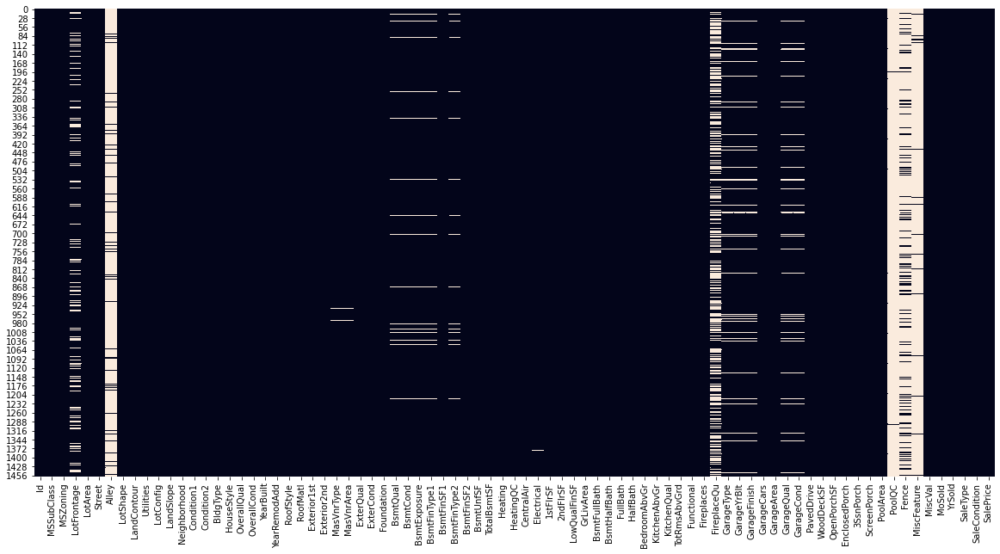

In [15]:
fig, ax = plt.subplots(figsize=(20,10))
sns.heatmap(train.isnull(), cbar=False, ax=ax)

Looking at the figure above it can be seen that the majority of the variables are complete, while some have a few missing and are candidates for either row removal or imputation. There are some other columns which show very high levels of incompleteness and may need for the entire column to be removed, but this is dependant as to whether the null value tells us anything.

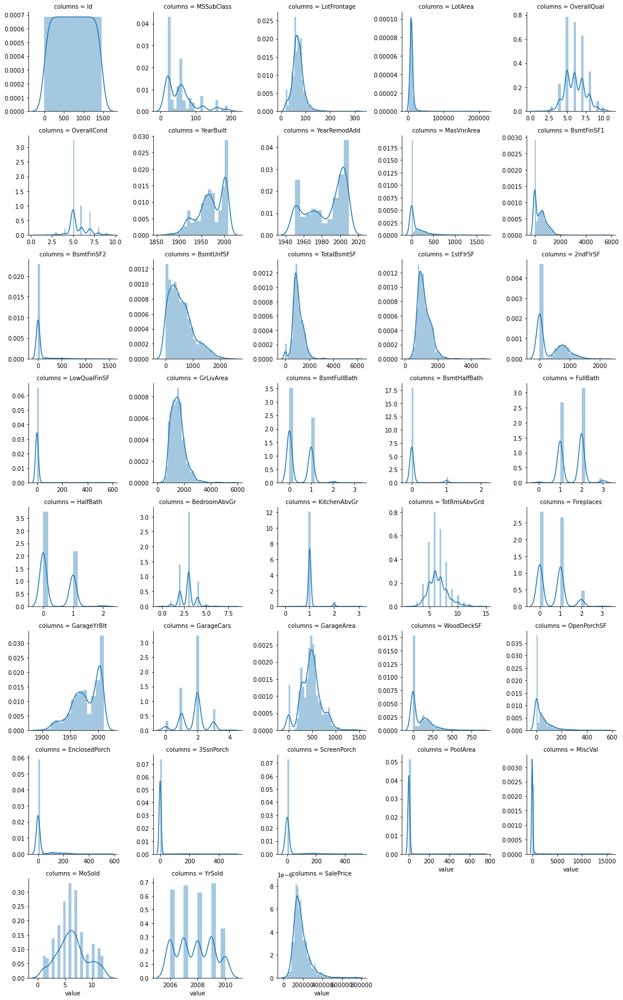

In [4]:
# Get only numeric columns
train_m = train.select_dtypes(include=[np.number]).melt(var_name='columns')

# Build distributions of each column
g = sns.FacetGrid(train_m, col='columns', col_wrap=5, sharex=False, sharey=False)
g = (g.map(sns.distplot, 'value'))

Several of the numeric distribuitions have significant outliers (e.g. LotArea & ScreenPorch) while others have significant number of 0's which may represent nulls (e.g. WoodDeckSF. 0 = No Wooden Deck)

## Baseline Model

Creation of a simple baseline model with no dataset modification. Using Random Forest as features don't have to be scaled.

In [5]:
percent_missing = train.isnull().sum() * 100 / len(train)
missing_value_df = pd.DataFrame({'column_name': train.columns,
                                 'percent_missing': percent_missing})

Quickly looking at percentage missing in order to remove columns with most missing. Looking at output, a reasonable cut off would be LotFrontage and higher for removal.

In [6]:
missing_value_df[missing_value_df["percent_missing"]>0].sort_values("percent_missing")

,column_name,percent_missing
Electrical,Electrical,0.068493
MasVnrType,MasVnrType,0.547945
MasVnrArea,MasVnrArea,0.547945
BsmtQual,BsmtQual,2.534247
BsmtCond,BsmtCond,2.534247
BsmtFinType1,BsmtFinType1,2.534247
BsmtExposure,BsmtExposure,2.602740
BsmtFinType2,BsmtFinType2,2.602740
GarageCond,GarageCond,5.547945
GarageQual,GarageQual,5.547945


In [7]:
# Dropping columns where % missing is above 15
cols_to_remove = missing_value_df[missing_value_df["percent_missing"]>15]["column_name"].values
train_redux = train.drop(columns=cols_to_remove)
train_redux = train_redux.drop(columns="Id")


In [12]:
# Drop all rows with na values and prove no na's exist in dataframe
train_redux = train_redux.dropna()
train_redux.reset_index(inplace=True)

print(f"NA values in train set: {train_redux.isna().any().any()}")

NA values in train set: False


In [18]:
# Get categorical columns
num_cols = train_redux._get_numeric_data().columns
cats = list(set(train_redux.columns) - set(num_cols))

In [19]:
from sklearn.preprocessing import OneHotEncoder

# Build OneHotEncoder with only category columns
enc = OneHotEncoder()
enc.fit(train_redux[cats])

column_names = enc.get_feature_names(cats)
train_cats = pd.DataFrame(enc.transform(train_redux[cats]).toarray(), columns=column_names)
train_df = train_redux[num_cols].join(train_cats)


In [20]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(train_df.drop(columns="SalePrice"), train_df["SalePrice"], test_size=0.33, random_state=42)


In [21]:
from sklearn.ensemble import RandomForestRegressor

baseline = RandomForestRegressor(random_state=42)

baseline.fit(X_train, y_train)

train_preds = baseline.predict(X_train)
test_preds = baseline.predict(X_test)


In [42]:
from sklearn.metrics import explained_variance_score, r2_score, mean_squared_error, mean_absolute_error

print(f"R2 (train/test):                 {r2_score(y_train, train_preds):.4f} / {r2_score(y_test, test_preds):.4f}")
print(f"MSE (train/test):                {mean_squared_error(y_train, train_preds):.4f} / {mean_squared_error(y_test, test_preds):.4f}")
print(f"MAE (train/test):                {mean_absolute_error(y_train, train_preds):.4f} / {mean_absolute_error(y_test, test_preds):.4f}")
print(f"Explained Variance (train/test): {explained_variance_score(y_train, train_preds):.4f} / {explained_variance_score(y_test, test_preds):.4f}")


R2 (train/test):                 0.9840 / 0.6848
MSE (train/test):                109898466.3602 / 1529618322.4467
MAE (train/test):                6578.8470 / 19622.7051
Explained Variance (train/test): 0.9840 / 0.6888


The result metrics above show a fairly competant model if looking just at the R2 values, but when looking at MSE & MAE it can be seen that the model suffers significantly. There is also a significant difference between the train and test set performance, indicating that the model has overfitted to the training data.

In [23]:
train_act_preds = pd.concat([y_train, pd.Series(train_preds, index=y_train.index, name="Prediction")], axis=1)
test_act_preds = pd.concat([y_test, pd.Series(test_preds, index=y_test.index, name="Prediction")], axis=1)

By looking

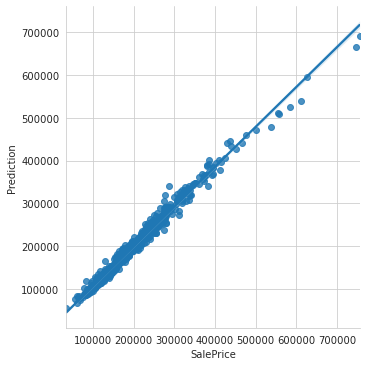

In [27]:
sns.set_style("whitegrid", {'axes.grid' : True})
sns.lmplot(x="SalePrice", y="Prediction", data=train_act_preds)

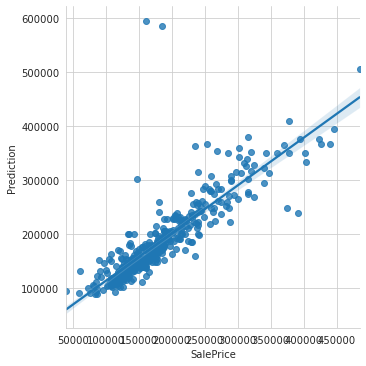

In [28]:
sns.lmplot(x="SalePrice", y="Prediction", data=test_act_preds)


In [30]:
train_act_preds["set"] = "train"
test_act_preds["set"] = "test"

combined_act_preds = pd.concat([train_act_preds, test_act_preds])
combined_act_preds["diff"] =  combined_act_preds["Prediction"] - combined_act_preds["SalePrice"]

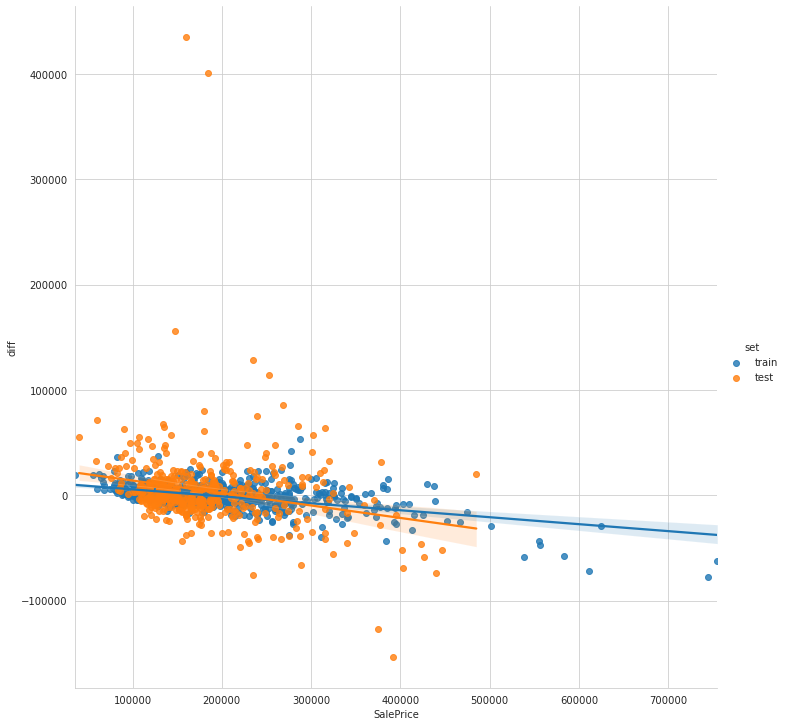

In [38]:
sns.lmplot(x="SalePrice", y="diff", hue="set", data=combined_act_preds, height=10)

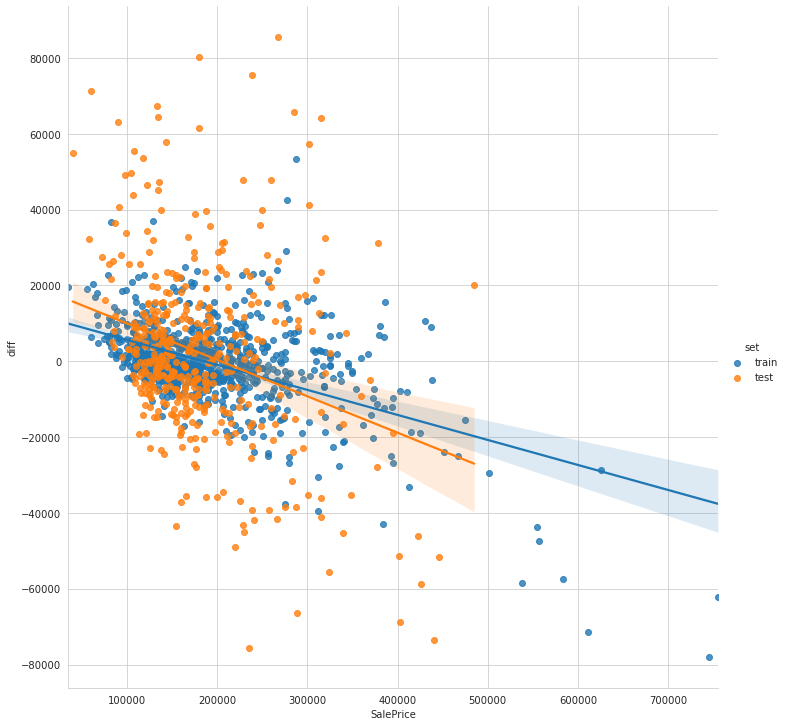

In [41]:
tmp = combined_act_preds[combined_act_preds["diff"].abs() < 100000]
sns.lmplot(x="SalePrice", y="diff", hue="set", data=tmp, height=10)